In [1]:
import xarray as xr
import traceback
import matplotlib.pyplot as plt
from metpy.calc import dewpoint_from_specific_humidity
from metpy.units import units
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from scipy.ndimage import gaussian_filter
from credit.animation import plot_global_animation, plot_regional_animation
import matplotlib.animation as animation
from glob import glob
import pandas as pd
from IPython.display import Video
from io import BytesIO
import imageio.v3 as iio
from multiprocessing import Pool
import matplotlib.style as mplstyle

mplstyle.use("fast")
%matplotlib inline

In [10]:
ds = xr.open_dataset(
    "/glade/derecho/scratch/dgagne/CREDIT/RAW_OUTPUT/wxformer_1h_gfs_post/2025-05-01T00Z/pred_2025-05-01T00Z_022.nc"
)

In [11]:
eds = xr.open_zarr(
    "/glade/derecho/scratch/dgagne/era5_zarr/y_TOTAL_2021-01-01_2021-12-31_staged.zarr"
)

2025-05-01 01:00:00
2025-05-01 01:00:00
2025-05-01 02:00:00
2025-05-01 03:00:00
2025-05-01 04:00:00
2025-05-01 05:00:00
2025-05-01 06:00:00
2025-05-01 07:00:00
2025-05-01 08:00:00
2025-05-01 09:00:00
2025-05-01 10:00:00
2025-05-01 11:00:00
2025-05-01 12:00:00
2025-05-01 13:00:00
2025-05-01 14:00:00
2025-05-01 15:00:00
2025-05-01 16:00:00
2025-05-01 17:00:00
2025-05-01 18:00:00
2025-05-01 19:00:00
2025-05-01 20:00:00
2025-05-01 21:00:00
2025-05-01 22:00:00
2025-05-01 23:00:00
2025-05-02 00:00:00


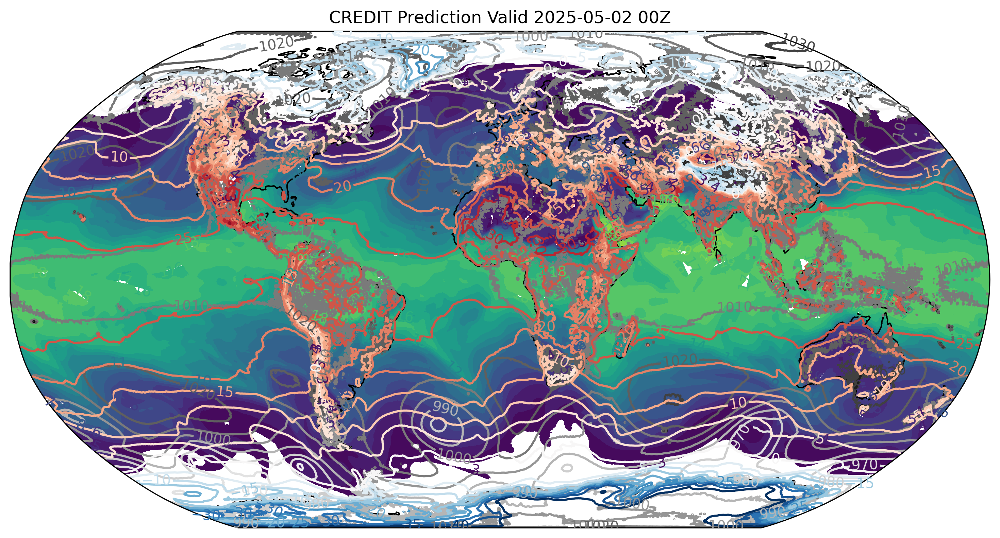

In [15]:
plot_global_animation(
    "/glade/derecho/scratch/dgagne/CREDIT/RAW_OUTPUT/wxformer_1h_gfs_post/2025-05-01T00Z/",
    "2025-05-01 00:00",
    1,
    24,
    output_video_file="./credit_surface_2025050100_gfs.mp4",
    contourf_config=dict(
        variable="Q",
        level=137,
        contourf_kwargs=dict(levels=np.arange(3, 25), cmap="viridis", extend="max"),
    ),
    contour_config=dict(
        pres=dict(
            variable="mean_sea_level_pressure",
            contour_kwargs=dict(levels=np.arange(950, 1060, 10), cmap="Greys"),
        ),
        temp=dict(
            variable="T",
            level=137,
            contour_kwargs=dict(levels=np.arange(-40, 45, 5), cmap="RdBu_r"),
        ),
    ),
    figure_kwargs=dict(figsize=(10, 6), dpi=300),
    colorbar_kwargs={"orientation": "horizontal", "shrink": 0.8},
)

In [ ]:
plot_regional_animation(
    "/glade/derecho/scratch/dgagne/CREDIT/RAW_OUTPUT/wxformer_1h_gfs_post/2025-05-01T00Z/",
    "2025-05-01 00:00",
    1,
    48,
    [238, 280, 25, 50],
    output_video_file="./credit_surface_2025050100_gfs_.mp4",
    contourf_config=dict(
        variable="Q",
        level=137,
        contourf_kwargs=dict(levels=np.arange(3, 25), cmap="viridis", extend="max"),
    ),
    contour_config=dict(
        pres=dict(
            variable="mean_sea_level_pressure",
            contour_kwargs=dict(levels=np.arange(950, 1060, 10), cmap="Greys"),
        ),
        temp=dict(
            variable="T",
            level=137,
            contour_kwargs=dict(levels=np.arange(-40, 45, 5), cmap="RdBu_r"),
        ),
    ),
    figure_kwargs=dict(figsize=(10, 6), dpi=300),
    colorbar_kwargs={"orientation": "horizontal", "shrink": 0.8},
)

In [44]:
Video(filename="/glade/work/dgagne/v_vid.mp4", embed=True, height=540, width=1920 / 2)

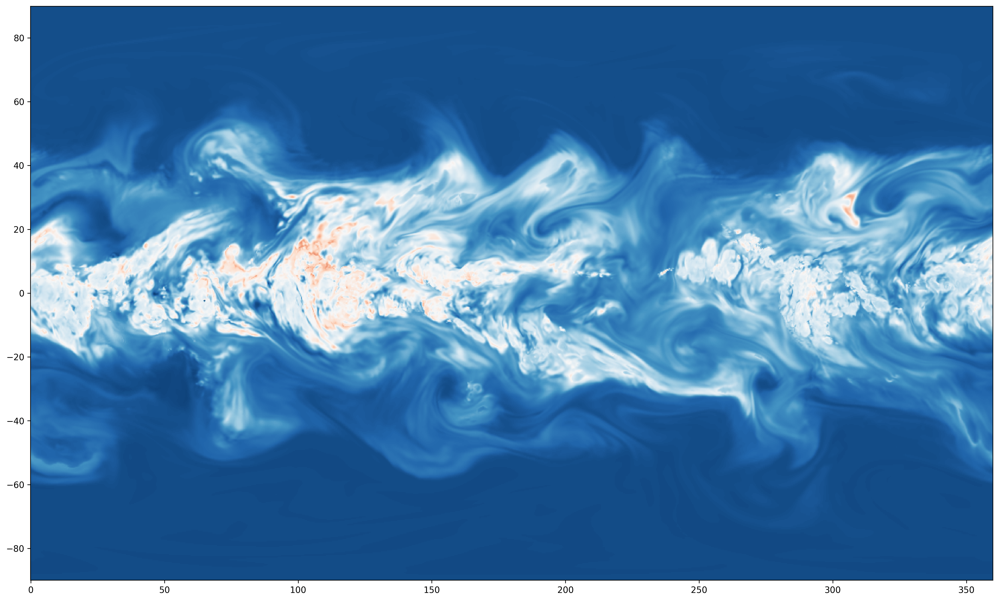

In [40]:
plt.figure(figsize=(20, 12), dpi=300)
plt.pcolormesh(
    eds["longitude"],
    eds["latitude"],
    eds["Q"].sel(time="2021-05-05 23:00", level=70) * 1000,
    cmap="RdBu_r",
    vmin=0,
    vmax=0.05,
)

In [15]:
dp = ds.sel(dict(latitude=36.4072, longitude=360 - 105.5731), method="nearest")

In [16]:
dewp = dewpoint_from_specific_humidity(
    pressure=dp["P_HEIGHT"][0] * units.Pa,
    temperature=dp["T_HEIGHT"][0] * units.K,
    specific_humidity=dp["Q_HEIGHT"][0] * units("kg/kg"),
)

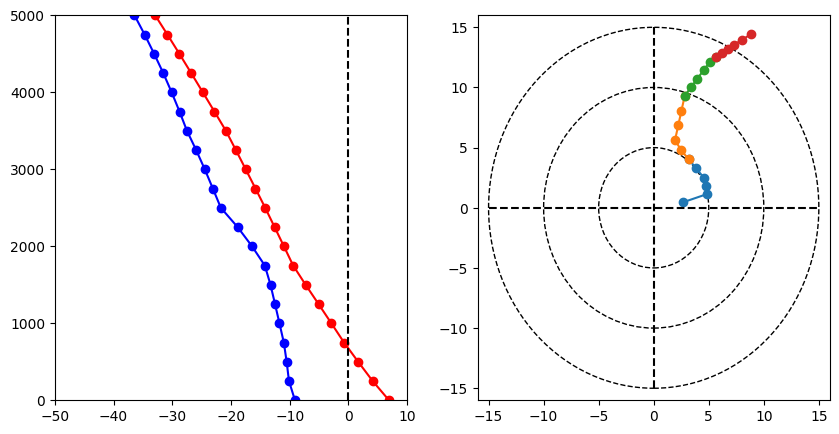

In [17]:
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(dp["T_HEIGHT"][0] - 273.15, dp["height_agl"], color="r", marker="o")
plt.plot(dewp, dp["height_agl"], color="b", marker="o")
plt.xlim(-50, 10)
plt.ylim(0, 5000)
plt.plot(np.zeros(6), np.arange(0, 6000, 1000), "k--")


plt.subplot(1, 2, 2)
height_indices = np.arange(0, 25, 5)
for i, hi in enumerate(height_indices[:-1]):
    plt.plot(
        dp["U_HEIGHT"][0, height_indices[i] : height_indices[i + 1] + 1],
        dp["V_HEIGHT"][0, height_indices[i] : height_indices[i + 1] + 1],
        marker="o",
    )

ax = plt.gca()
plt.xlim(-16, 16)
plt.ylim(-16, 16)
for radius in np.arange(5, 20, 5):
    circle = plt.Circle((0, 0), radius, edgecolor="k", linestyle="--", facecolor="none")
    ax.add_patch(circle)
plt.plot(np.zeros(31), np.arange(-15, 16), "k--")
plt.plot(np.arange(-15, 16), np.zeros(31), "k--")

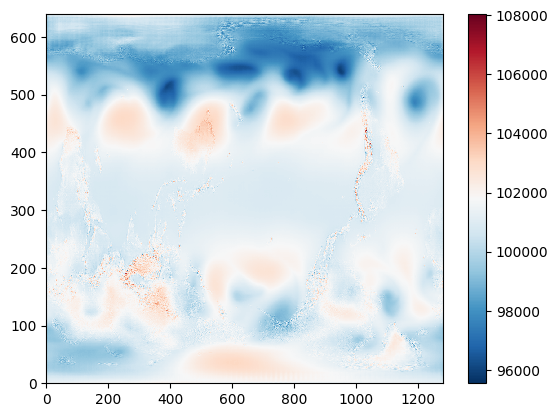

In [18]:
plt.pcolormesh(ds["mean_sea_level_pressure"][0], cmap="RdBu_r")
plt.colorbar()

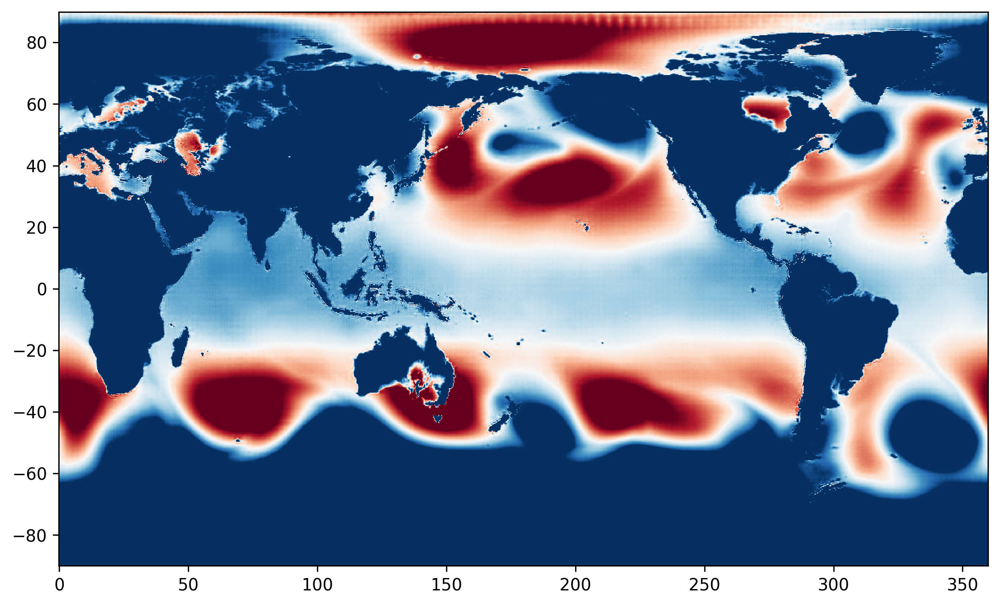

In [13]:
plt.figure(figsize=(10, 6), dpi=300)
plt.pcolormesh(
    ds["longitude"],
    ds["latitude"],
    ds["SP"][0] / 100 - 1013.25,
    vmin=-10,
    vmax=10,
    cmap="RdBu_r",
)

2025-05-01 01Z
2025-05-01 01Z
2025-05-01 02Z
2025-05-01 03Z
2025-05-01 04Z
2025-05-01 05Z
2025-05-01 06Z
2025-05-01 07Z
2025-05-01 08Z
2025-05-01 09Z
2025-05-01 10Z
2025-05-01 11Z
2025-05-01 12Z
2025-05-01 13Z
2025-05-01 14Z
2025-05-01 15Z
2025-05-01 16Z
2025-05-01 17Z
2025-05-01 18Z
2025-05-01 19Z
2025-05-01 20Z
2025-05-01 21Z
2025-05-01 22Z
2025-05-01 23Z
2025-05-02 00Z
2025-05-02 01Z
2025-05-02 02Z
2025-05-02 03Z
2025-05-02 04Z
2025-05-02 05Z
2025-05-02 06Z
2025-05-02 07Z
2025-05-02 08Z
2025-05-02 09Z
2025-05-02 10Z
2025-05-02 11Z
2025-05-02 12Z
2025-05-02 13Z
2025-05-02 14Z
2025-05-02 15Z
2025-05-02 16Z
2025-05-02 17Z
2025-05-02 18Z
2025-05-02 19Z
2025-05-02 20Z
2025-05-02 21Z
2025-05-02 22Z
2025-05-02 23Z
2025-05-03 00Z
2025-05-03 01Z
2025-05-03 02Z
2025-05-03 03Z
2025-05-03 04Z
2025-05-03 05Z
2025-05-03 06Z
2025-05-03 07Z
2025-05-03 08Z
2025-05-03 09Z
2025-05-03 10Z
2025-05-03 11Z
2025-05-03 12Z
2025-05-03 13Z
2025-05-03 14Z
2025-05-03 15Z
2025-05-03 16Z
2025-05-03 17Z
2025-05-03

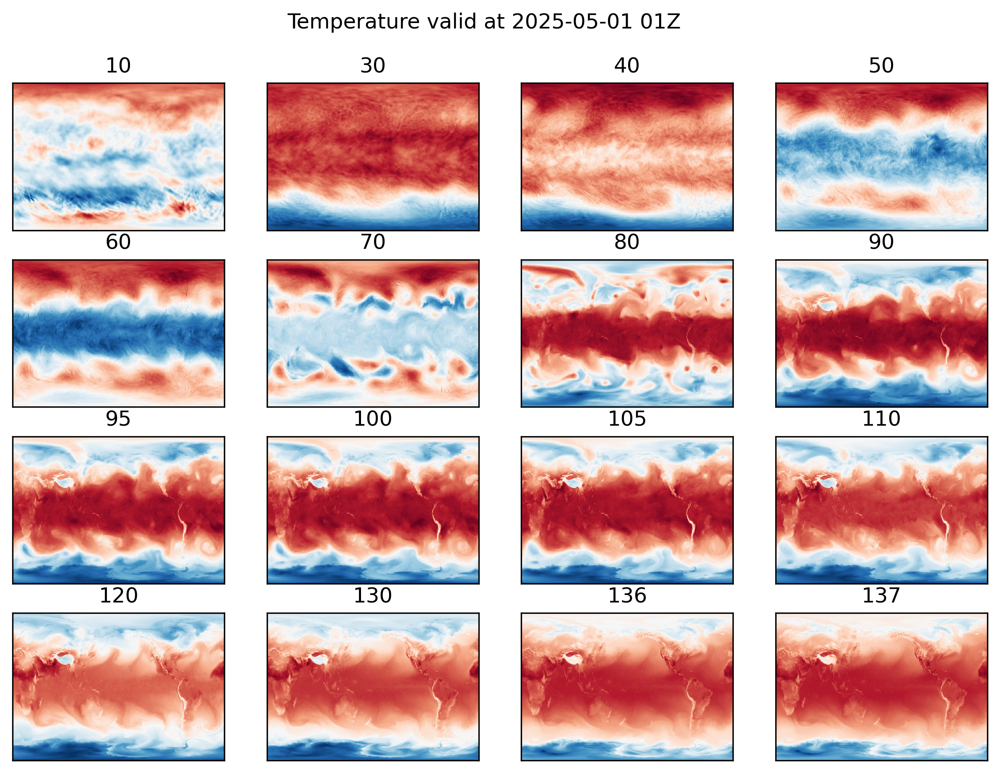

In [39]:
fig, axes = plt.subplots(4, 4, figsize=(10, 7), dpi=300)


def plot_step(i):
    ctime = pd.Timestamp(ds["time"][i].values).strftime("%Y-%m-%d %HZ")
    print(ctime)
    for a, ax in enumerate(axes.ravel()):
        ax.clear()
        ax.pcolormesh(ds["longitude"], ds["latitude"], ds["T"][i, a], cmap="RdBu_r")
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title(ds["level"].values[a], fontsize=12)
    plt.suptitle(f"Temperature valid at {ctime}", y=0.96)


ani = animation.FuncAnimation(fig, plot_step, frames=120)
ani.save(filename=f"credit_T_1h_2025-05-01.mp4", writer="ffmpeg", fps=10, dpi=300)

In [2]:
def plot_frame(
    i,
    variable="U",
    path="/glade/derecho/scratch/dgagne/CREDIT/RAW_OUTPUT/wxformer_1h_gfs_post/2025-05-01T00Z/",
):
    try:
        nc_files = sorted(glob(path + "*.nc"))
        with xr.open_dataset(nc_files[i]) as ds:
            fig, axes = plt.subplots(4, 4, figsize=(6.4, 3.6), dpi=300)
            ctime = pd.Timestamp(ds["time"][0].values).strftime("%Y-%m-%d %HZ")
            print(ctime)
            for a, ax in enumerate(axes.ravel()):
                ax.clear()
                ax.pcolormesh(
                    ds["longitude"],
                    ds["latitude"],
                    ds[variable][0, a],
                    cmap="RdBu_r",
                    vmin=-30,
                    vmax=30,
                )
                ax.set_xticks([])
                ax.set_yticks([])
                ax.set_title(ds["level"].values[a], fontsize=6, pad=1)
            plt.suptitle(f"{variable} valid at {ctime}", y=0.96)
            with BytesIO() as buf:
                fig.savefig(buf, format="png", dpi=300, bbox_inches="tight")
                plt.close(fig)
                image = iio.imread(buf.getvalue(), mode="RGB")
    except Exception as e:
        print(traceback.format_exc(e))
        raise e
    return image


pool = Pool(12)
results = pool.map(plot_frame, np.arange(120))
pool.close()
pool.join()

2025-05-01 01Z
2025-05-01 07Z
2025-05-01 16Z2025-05-01 04Z

2025-05-01 19Z
2025-05-01 10Z2025-05-01 13Z

2025-05-02 04Z2025-05-01 22Z

2025-05-02 01Z
2025-05-02 07Z
2025-05-02 10Z
2025-05-02 11Z
2025-05-01 02Z2025-05-01 05Z

2025-05-01 17Z
2025-05-02 05Z
2025-05-02 02Z
2025-05-01 20Z
2025-05-02 08Z
2025-05-01 23Z
2025-05-01 11Z2025-05-01 14Z

2025-05-01 08Z
2025-05-02 12Z
2025-05-01 06Z
2025-05-02 03Z
2025-05-01 21Z2025-05-01 18Z

2025-05-02 09Z2025-05-02 00Z

2025-05-02 06Z
2025-05-01 15Z
2025-05-01 12Z
2025-05-01 03Z
2025-05-01 09Z
2025-05-02 13Z
2025-05-02 16Z
2025-05-02 19Z
2025-05-02 22Z
2025-05-03 01Z
2025-05-03 04Z
2025-05-03 07Z
2025-05-03 10Z
2025-05-03 13Z
2025-05-03 16Z
2025-05-03 19Z
2025-05-03 22Z
2025-05-02 14Z
2025-05-02 20Z
2025-05-02 17Z
2025-05-03 14Z
2025-05-03 02Z2025-05-03 05Z

2025-05-02 23Z
2025-05-03 08Z2025-05-03 20Z
2025-05-03 11Z

2025-05-03 17Z
2025-05-03 23Z
2025-05-02 15Z
2025-05-02 21Z
2025-05-02 18Z
2025-05-03 06Z
2025-05-03 15Z
2025-05-03 21Z
2025-05-03

In [3]:
with iio.imopen("/glade/work/dgagne/u_vid.mp4", "w", plugin="pyav") as writer:
    writer.init_video_stream(codec="h264", fps=24)
    writer.write(results)

In [2]:
Video(filename="/glade/work/dgagne/u_vid.mp4", embed=True, height=540, width=1920 / 2)

In [6]:
def plot_zframe(
    date_val,
    variable="V",
    path="/glade/derecho/scratch/dgagne/era5_zarr/y_TOTAL_2021-01-01_2021-12-31_staged.zarr",
):
    try:
        with xr.open_zarr(path) as ds:
            fig, axes = plt.subplots(4, 4, figsize=(6.4, 3.6), dpi=300)
            ctime = pd.Timestamp(date_val).strftime("%Y-%m-%d %HZ")
            print(date_val)
            for a, ax in enumerate(axes.ravel()):
                ax.clear()
                ax.pcolormesh(
                    ds["longitude"],
                    ds["latitude"],
                    ds[variable].sel(time=date_val)[a],
                    cmap="RdBu_r",
                    vmin=-30,
                    vmax=30,
                )
                ax.set_xticks([])
                ax.set_yticks([])
                ax.set_title(ds["level"].values[a], fontsize=6, pad=1)
            plt.suptitle(f"{variable} valid at {ctime}", y=0.96)
            with BytesIO() as buf:
                fig.savefig(buf, format="png", dpi=300, bbox_inches="tight")
                plt.close(fig)
                image = iio.imread(buf.getvalue(), mode="RGB")
    except Exception as e:
        print(traceback.format_exc(e))
        raise e
    return image


pool = Pool(12)
dates = pd.date_range(start="2021-05-01 01:00", end="2021-05-06 00:00", freq="1h")
results = pool.map(plot_zframe, dates)
pool.close()
pool.join()
with iio.imopen("/glade/work/dgagne/v_vid_e5.mp4", "w", plugin="pyav") as writer:
    writer.init_video_stream(codec="h264", fps=24)
    writer.write(results)

2021-05-01 19:00:002021-05-01 01:00:002021-05-01 16:00:00
2021-05-01 07:00:00


2021-05-01 13:00:00
2021-05-02 01:00:002021-05-01 22:00:002021-05-02 10:00:002021-05-01 10:00:00


2021-05-01 04:00:00

2021-05-02 04:00:00
2021-05-02 07:00:00
2021-05-02 11:00:00
2021-05-01 14:00:002021-05-01 17:00:00
2021-05-02 08:00:00
2021-05-02 02:00:00

2021-05-02 05:00:002021-05-01 23:00:00

2021-05-01 20:00:00
2021-05-01 11:00:00
2021-05-01 02:00:00
2021-05-01 08:00:002021-05-01 05:00:00

2021-05-02 12:00:00
2021-05-01 18:00:00
2021-05-02 06:00:00
2021-05-01 15:00:00
2021-05-01 21:00:002021-05-02 09:00:00

2021-05-02 03:00:00
2021-05-02 00:00:00
2021-05-01 12:00:00
2021-05-01 06:00:00
2021-05-01 09:00:00
2021-05-01 03:00:00
2021-05-02 13:00:00
2021-05-02 16:00:00
2021-05-02 19:00:00
2021-05-02 22:00:00
2021-05-03 01:00:00
2021-05-03 04:00:00
2021-05-03 07:00:00
2021-05-03 10:00:00
2021-05-03 13:00:00
2021-05-03 16:00:00
2021-05-03 19:00:00
2021-05-03 22:00:00
2021-05-02 14:00:00
2021-05-02 17:00:00


In [7]:
Video(
    filename="/glade/work/dgagne/v_vid_e5.mp4", embed=True, height=540, width=1920 / 2
)

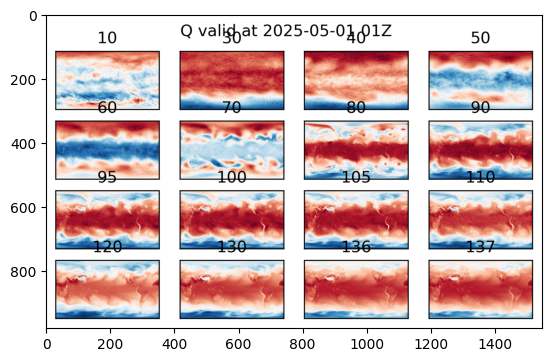

In [31]:
plt.imshow(results[0])

In [17]:
dir(iio)

['__all__',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__spec__',
 'imiter',
 'immeta',
 'imopen',
 'improps',
 'imread',
 'imwrite',
 'np']

In [ ]:
pd.Timestamp(ds["time"][5].values).strftime("%Y-%m-%d %HZ")

In [24]:
ds["Q"].min()

<xarray.DataArray 'Q' ()> Size: 4B
array(9.778887e-09, dtype=float32)

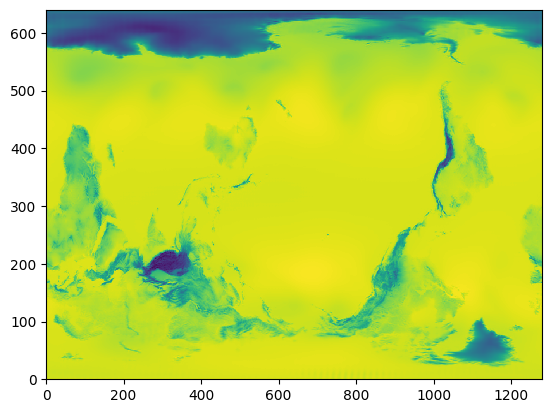

In [25]:
plt.pcolormesh(ds["SP"][0])

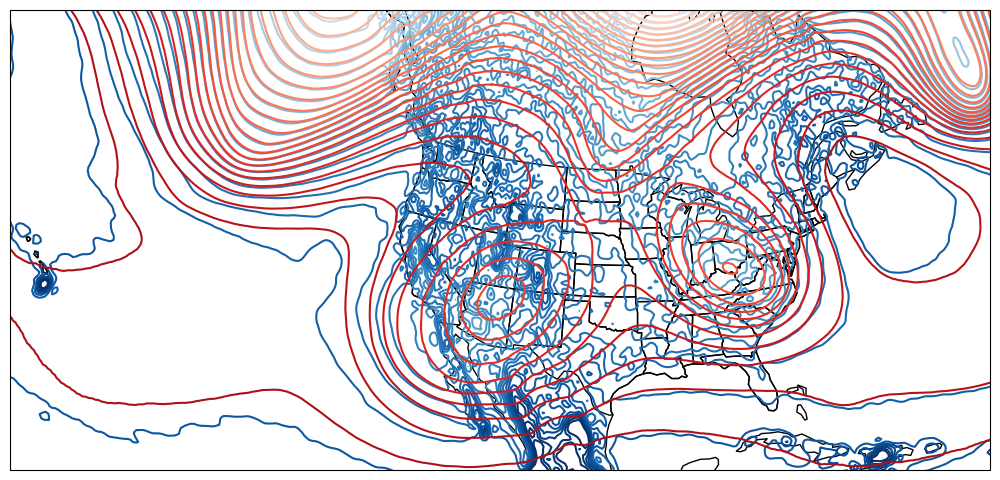

In [27]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_axes((0.02, 0.02, 0.98, 0.98), projection=ccrs.LambertConformal())
ax.set_extent([200, 300, 20, 50], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.STATES)
plt.contour(
    ds["longitude"],
    ds["latitude"],
    gaussian_filter(ds["Z_PRES"][0, 0] / 9.81 / 10, 1),
    np.arange(500, 600, 3),
    transform=ccrs.PlateCarree(),
    cmap="Blues",
)
plt.contour(
    ds["longitude"],
    ds["latitude"],
    ds["Z500"][0] / 9.81 / 10,
    np.arange(500, 600, 3),
    transform=ccrs.PlateCarree(),
    cmap="Reds",
)

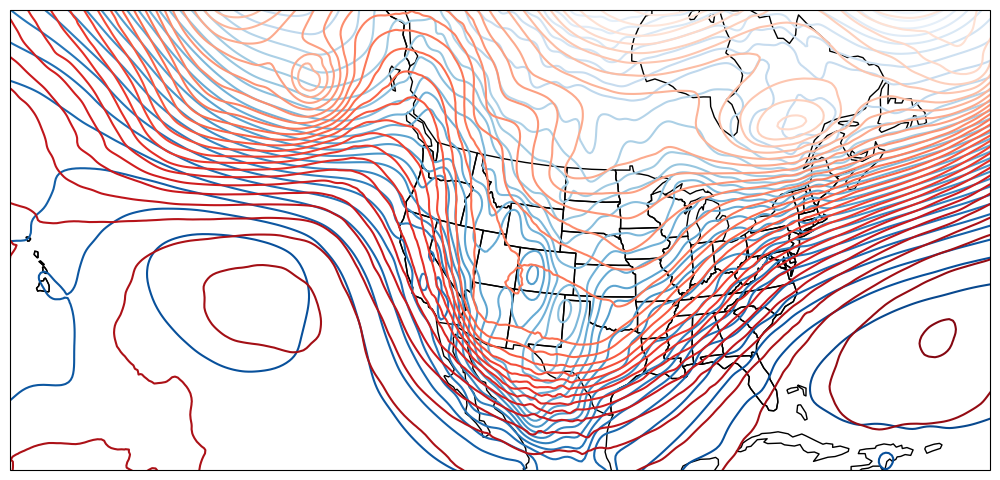

In [99]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_axes((0.02, 0.02, 0.98, 0.98), projection=ccrs.LambertConformal())
ax.set_extent([200, 300, 20, 50], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.STATES)
plt.contour(
    ds["longitude"],
    ds["latitude"],
    gaussian_filter(ds["Z_PRES"][0, 3] / 9.81 / 10, 3),
    np.arange(500, 600, 3),
    transform=ccrs.PlateCarree(),
    cmap="Blues",
)
plt.contour(
    ds["longitude"],
    ds["latitude"],
    eds["Z500"].sel(time=ds["time"][0]) / 9.81 / 10,
    np.arange(500, 600, 3),
    transform=ccrs.PlateCarree(),
    cmap="Reds",
)

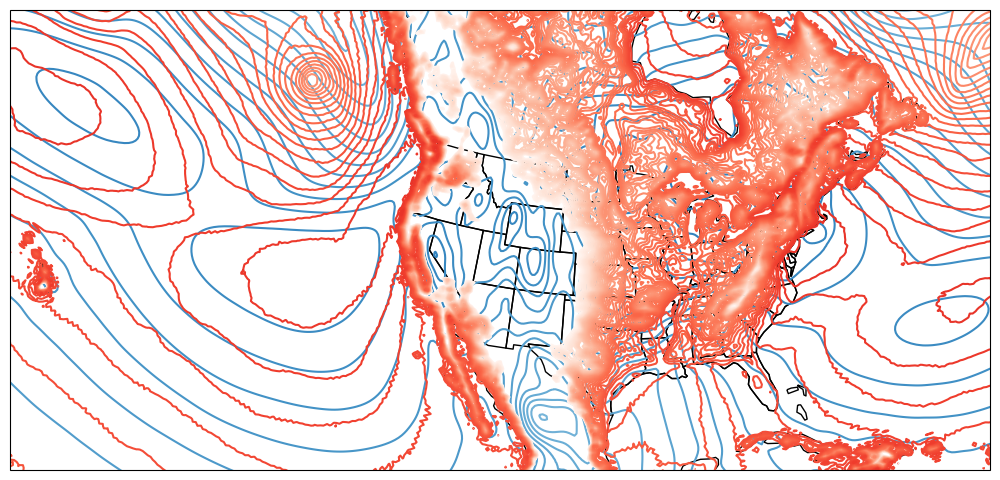

In [105]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_axes((0.02, 0.02, 0.98, 0.98), projection=ccrs.LambertConformal())
ax.set_extent([200, 300, 20, 50], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.STATES)
plt.contour(
    ds["longitude"],
    ds["latitude"],
    gaussian_filter(ds["mean_sea_level_pressure"][0], 3) / 100,
    np.arange(900, 1100, 3),
    transform=ccrs.PlateCarree(),
    cmap="Blues",
)
plt.contour(
    ds["longitude"],
    ds["latitude"],
    eds["SP"].sel(time=ds["time"][0]) / 100,
    np.arange(900, 1100, 3),
    transform=ccrs.PlateCarree(),
    cmap="Reds",
)
# plt.contour(ds["longitude"], ds["latitude"], ds["SP"][0] / 100,
#            np.arange(900, 1100, 3), transform=ccrs.PlateCarree(), cmap="Reds")

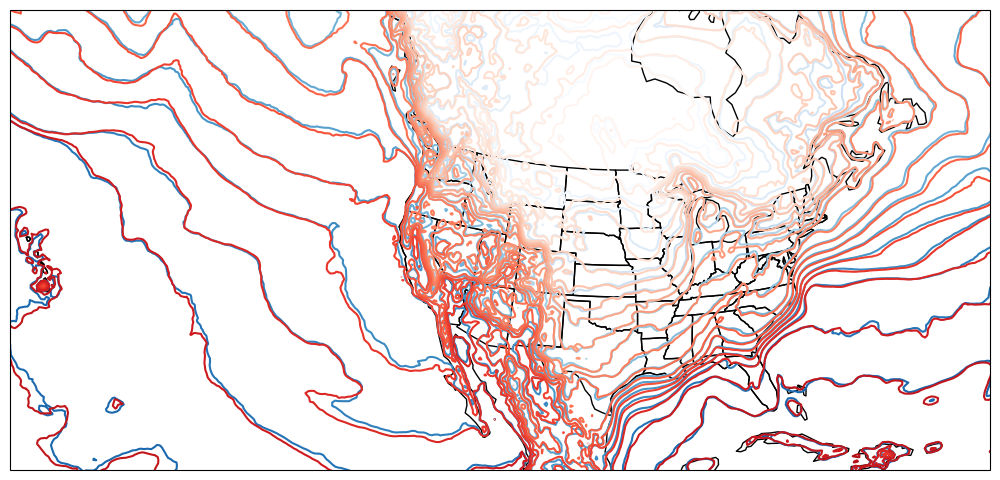

In [90]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_axes((0.02, 0.02, 0.98, 0.98), projection=ccrs.LambertConformal())
ax.set_extent([200, 300, 20, 50], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.STATES)
plt.contour(
    ds["longitude"],
    ds["latitude"],
    ds["t2m"][0] - 273,
    np.arange(-30, 40, 3),
    transform=ccrs.PlateCarree(),
    cmap="Blues",
)
plt.contour(
    ds["longitude"],
    ds["latitude"],
    ds["T"][0, -1] - 273,
    np.arange(-30, 40, 3),
    transform=ccrs.PlateCarree(),
    cmap="Reds",
)

In [ ]:
ds["Z_PRES"][0, 3] / 9.81 / 10

In [84]:
ds

<xarray.Dataset> Size: 1GB
Dimensions:                  (time: 1, level: 16, latitude: 640,
                              longitude: 1280, pressure: 8, height_agl: 25)
Coordinates:
  * time                     (time) datetime64[ns] 8B 2021-02-23
  * level                    (level) int64 128B 10 30 40 50 ... 120 130 136 137
  * latitude                 (latitude) float64 5kB 89.78 89.51 ... -89.78
  * longitude                (longitude) float64 10kB 0.0 0.2812 ... 359.4 359.7
  * pressure                 (pressure) float64 64B 200.0 250.0 ... 925.0 1e+03
  * height_agl               (height_agl) float64 200B 0.0 250.0 ... 6e+03
Data variables: (12/25)
    U                        (time, level, latitude, longitude) float32 52MB ...
    V                        (time, level, latitude, longitude) float32 52MB ...
    T                        (time, level, latitude, longitude) float32 52MB ...
    Q                        (time, level, latitude, longitude) float32 52MB ...
    SP                       (time, latitude, longitude) float32 3MB 1.007e+0...
    t2m                      (time, latitude, longitude) float32 3MB ...
    ...                       ...
    mean_sea_level_pressure  (time, latitude, longitude) float64 7MB ...
    U_HEIGHT                 (time, height_agl, latitude, longitude) float32 82MB ...
    V_HEIGHT                 (time, height_agl, latitude, longitude) float32 82MB ...
    T_HEIGHT                 (time, height_agl, latitude, longitude) float32 82MB ...
    Q_HEIGHT                 (time, height_agl, latitude, longitude) float32 82MB ...
    P_HEIGHT                 (time, height_agl, latitude, longitude) float32 82MB ...
Attributes:
    Conventions:  CF-1.11

In [106]:
ge5_surf = xr.open_zarr(
    "gs://gcp-public-data-arco-era5/co/single-level-surface.zarr-v2/"
)

/glade/derecho/scratch/dgagne/tmp/ipykernel_59719/3368382344.py:1: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ge5_surf = xr.open_zarr("gs://gcp-public-data-arco-era5/co/single-level-surface.zarr-v2/")


In [108]:
lnsp = ge5_surf["lnsp"].sel(time=ds["time"][0])

(20.0, 50.0)

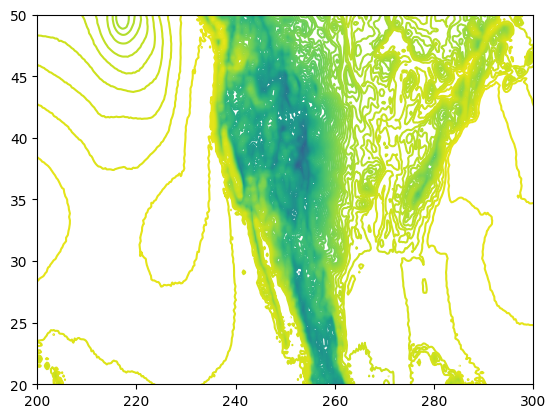

In [122]:
plt.contour(
    eds["longitude"], eds["latitude"], eds["SP"].sel(time=ds["time"][0]) / 100, 100
)
plt.xlim(200, 300)
plt.ylim(20, 50)

(20.0, 50.0)

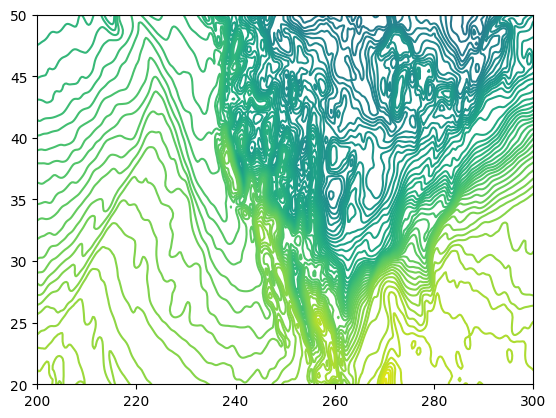

In [121]:
plt.contour(
    eds["longitude"],
    eds["latitude"],
    gaussian_filter(eds["t2m"].sel(time=ds["time"][0]) / 100, 1),
    100,
)
plt.xlim(200, 300)
plt.ylim(20, 50)

In [123]:
cam_ds = xr.open_dataset(
    "/glade/derecho/scratch/wchapman/archive/b.e21.CREDIT_climate_branch/atm/hist/b.e21.CREDIT_climate_branch.cam.h1.2014-12-24-00000.nc"
)

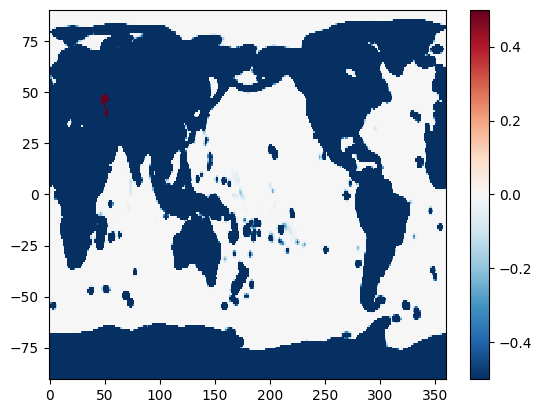

In [217]:
plt.pcolormesh(
    cam_ds["lon"],
    cam_ds["lat"],
    cam_ds["PS"][0] - cam_ds["PSL"][0],
    vmin=-0.5,
    vmax=0.5,
    cmap="RdBu_r",
)
plt.colorbar()

In [126]:
cam_ds

<xarray.Dataset> Size: 683MB
Dimensions:       (lat: 192, lon: 288, lev: 32, ilev: 33, time: 4, nbnd: 2)
Coordinates:
  * lat           (lat) float64 2kB -90.0 -89.06 -88.12 ... 88.12 89.06 90.0
  * lon           (lon) float64 2kB 0.0 1.25 2.5 3.75 ... 356.2 357.5 358.8
  * lev           (lev) float64 256B 3.643 7.595 14.36 ... 957.5 976.3 992.6
  * ilev          (ilev) float64 264B 2.255 5.032 10.16 ... 967.5 985.1 1e+03
  * time          (time) object 32B 2014-12-24 00:00:00 ... 2014-12-24 18:00:00
Dimensions without coordinates: nbnd
Data variables: (12/69)
    gw            (lat) float64 2kB ...
    hyam          (lev) float64 256B ...
    hybm          (lev) float64 256B ...
    P0            float64 8B ...
    hyai          (ilev) float64 264B ...
    hybi          (ilev) float64 264B ...
    ...            ...
    TS            (time, lat, lon) float64 2MB ...
    U             (time, lev, lat, lon) float64 57MB ...
    U10           (time, lat, lon) float64 2MB ...
    V             (time, lev, lat, lon) float64 57MB ...
    Z500          (time, lat, lon) float64 2MB ...
    ZMMU          (time, lev, lat, lon) float64 57MB ...
Attributes:
    Conventions:       CF-1.0
    source:            CAM
    case:              b.e21.CREDIT_climate_branch
    logname:           wchapman
    host:              derecho6
    initial_file:      b.e21.BHIST.f09_g17.CMIP6-historical.004.cam.i.2000-01...
    topography_file:   /glade/campaign/cesm/cesmdata/inputdata/atm/cam/topo/f...
    model_doi_url:     https://doi.org/10.5065/D67H1H0V
    time_period_freq:  hour_6

In [4]:
gds = xr.open_zarr(
    "gs://gcp-public-data-arco-era5/ar/full_37-1h-0p25deg-chunk-1.zarr-v3"
)

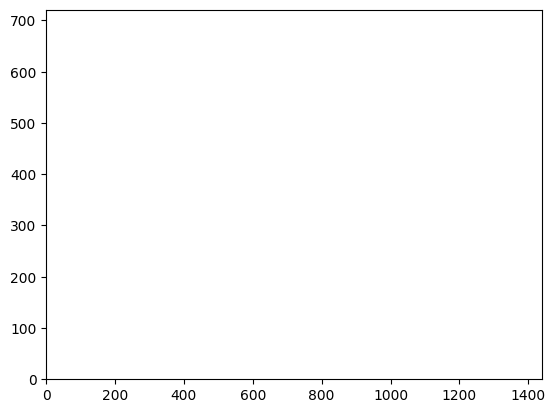

In [15]:
plt.pcolormesh(gds["geopotential_at_surface"][-5] - gds["geopotential_at_surface"][-4])

In [31]:
np.max(
    np.abs(
        gds["geopotential_at_surface"].sel(time="1991-12-01 00:00").values
        - gds["geopotential_at_surface"].sel(time="2021-01-01 00:00").values
    )
)

np.float32(0.0)

In [7]:
terrain = gds["geopotential_at_surface"].sel(time="1991-12-01 00:00").values

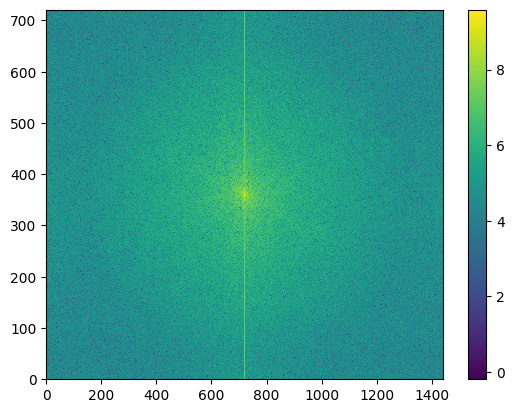

In [44]:
plt.pcolormesh(np.log10(np.abs(np.fft.fftshift(np.fft.fft2(terrain)).real)))
plt.colorbar()

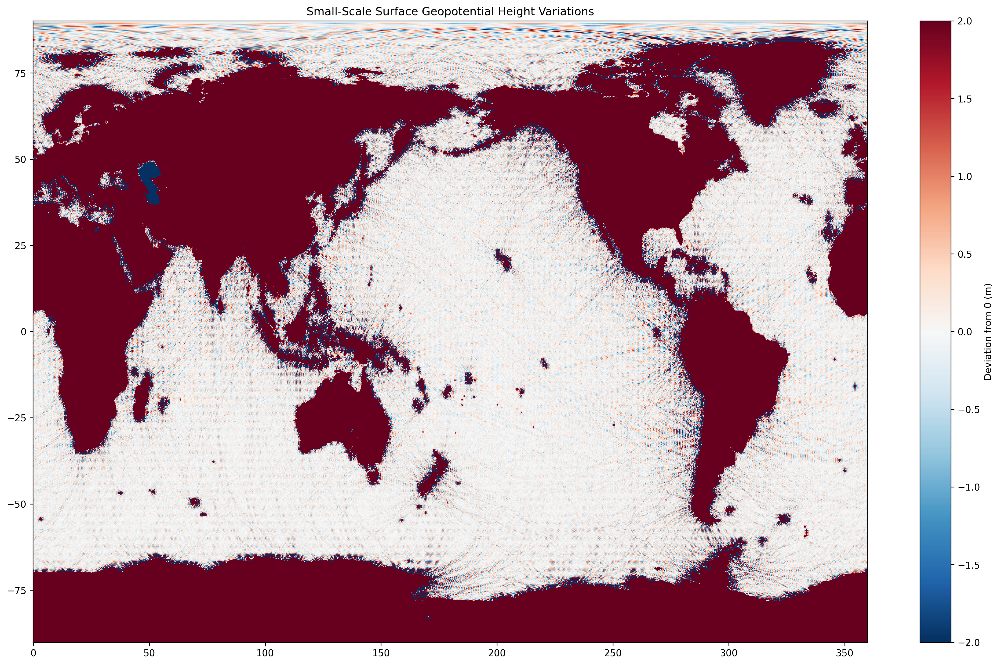

In [19]:
plt.figure(figsize=(20, 12), dpi=300)
plt.pcolormesh(
    gds["longitude"], gds["latitude"], terrain / 9.81, vmin=-2, vmax=2, cmap="RdBu_r"
)
plt.colorbar(label="Deviation from 0 (m)")
plt.title("Small-Scale Surface Geopotential Height Variations")
plt.savefig("geopotential_variations.png", dpi=300, bbox_inches="tight")

In [50]:
e5_static = xr.open_dataset(
    "/glade/campaign/cisl/aiml/credit/static_scalers/static_whole_20250416.nc"
)

(20.0, 60.0)

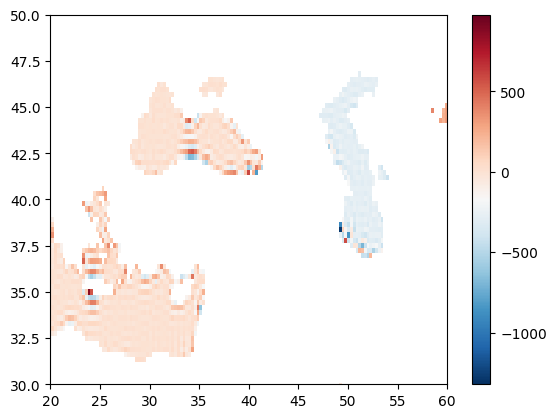

In [83]:
plt.pcolormesh(
    e5_static["longitude"],
    e5_static["latitude"],
    np.where(
        (e5_static["LSM"] < 0.1) & (e5_static["Z_GDS4_SFC"] < 1000),
        e5_static["Z_GDS4_SFC"],
        np.nan,
    ),
    cmap="RdBu_r",
)
plt.colorbar()
plt.ylim(30, 50)
plt.xlim(20, 60)

/glade/u/home/dgagne/conda-envs/credit-casper/lib/python3.11/site-packages/xarray/core/computation.py:824: RuntimeWarning: invalid value encountered in log
  result_data = func(*input_data)


(20.0, 60.0)

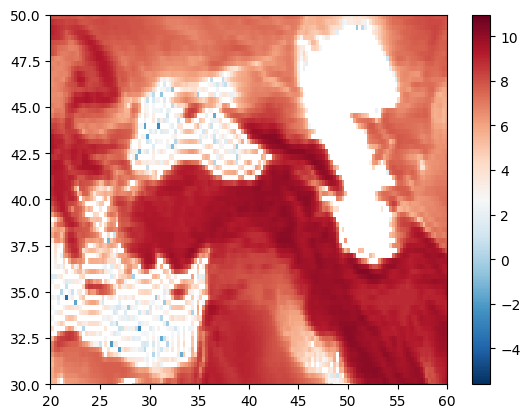

In [85]:
plt.pcolormesh(
    e5_static["longitude"],
    e5_static["latitude"],
    np.log(e5_static["Z_GDS4_SFC"]),
    cmap="RdBu_r",
)
plt.colorbar()
plt.ylim(30, 50)
plt.xlim(20, 60)

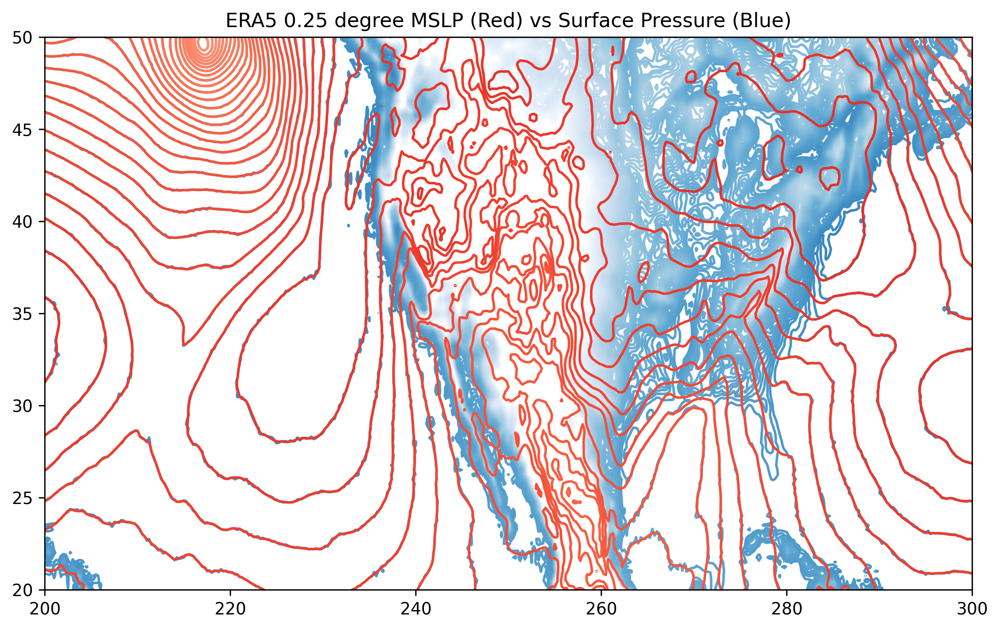

In [153]:
plt.figure(figsize=(10, 6), dpi=300)
plt.contour(
    gds["longitude"],
    gds["latitude"],
    gds["surface_pressure"].sel(time=ds["time"][0]) / 100,
    np.arange(900, 1100, 2),
    cmap="Blues",
)

plt.contour(
    gds["longitude"],
    gds["latitude"],
    gds["mean_sea_level_pressure"].sel(time=ds["time"][0]) / 100,
    np.arange(900, 1100, 2),
    cmap="Reds",
)
plt.title("ERA5 0.25 degree MSLP (Red) vs Surface Pressure (Blue)")
plt.xlim(200, 300)
plt.ylim(20, 50)
plt.savefig("mslp_sp.png", dpi=300, bbox_inches="tight")

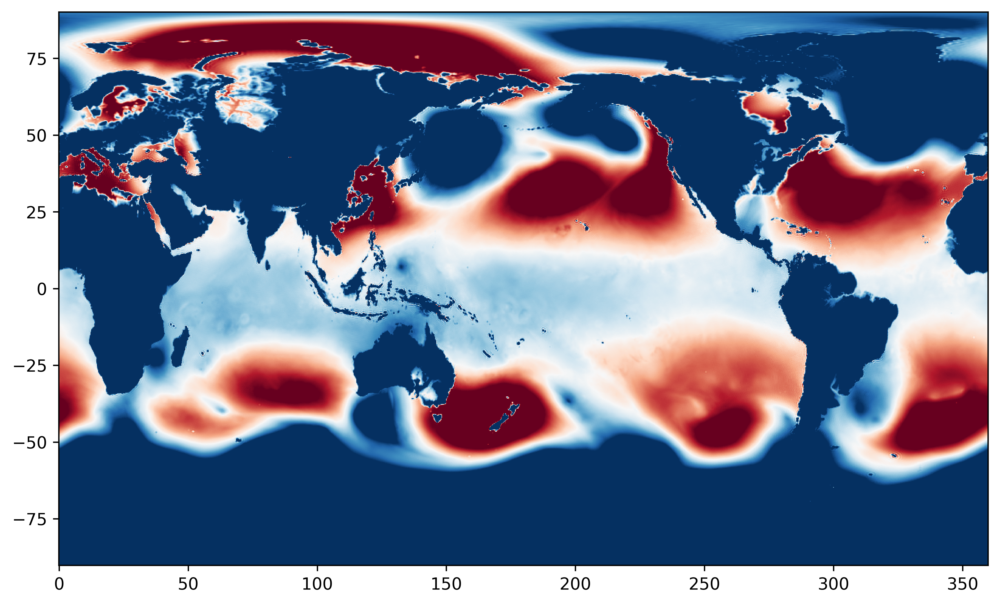

In [239]:
plt.figure(figsize=(10, 6), dpi=600)
plt.pcolormesh(
    gds["longitude"],
    gds["latitude"],
    gds["surface_pressure"].sel(time=ds["time"][0]) / 100 - 1013.25,
    vmin=-10,
    vmax=10,
    cmap="RdBu_r",
)
plt.savefig("sp_diff.png", dpi=600)

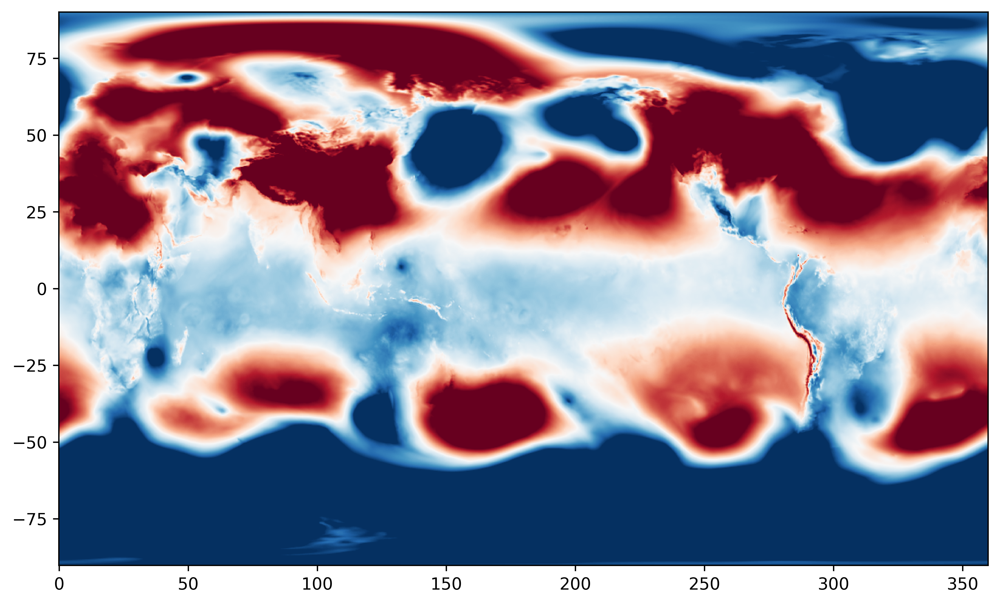

In [241]:
plt.figure(figsize=(10, 6), dpi=600)
plt.pcolormesh(
    gds["longitude"],
    gds["latitude"],
    gds["mean_sea_level_pressure"].sel(time=ds["time"][0]) / 100 - 1013.25,
    vmin=-10,
    vmax=10,
    cmap="RdBu_r",
)
plt.savefig("mslp_diff.png", dpi=600)

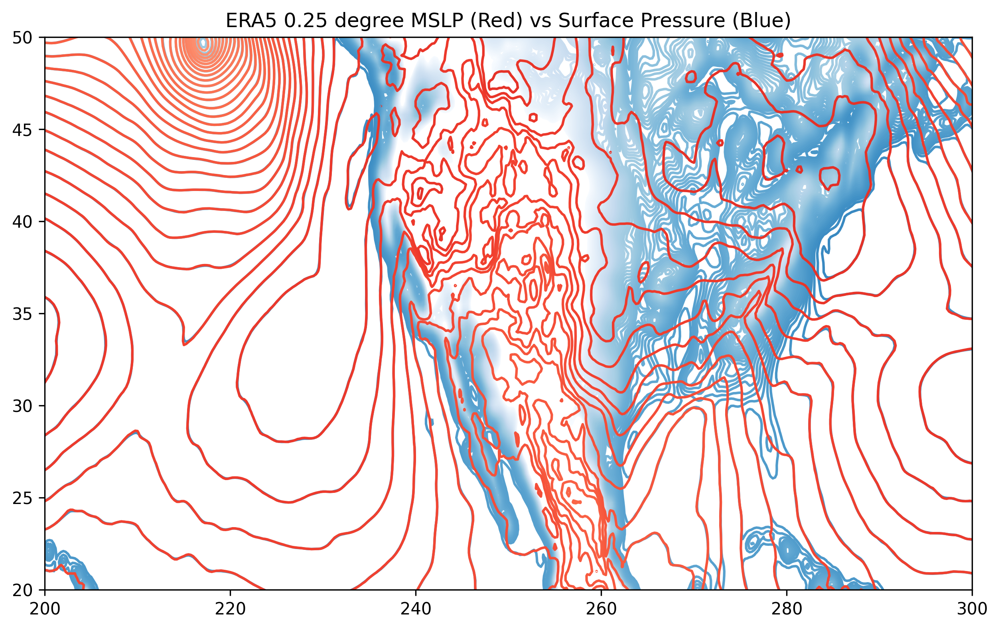

In [159]:
plt.figure(figsize=(10, 6), dpi=300)
plt.contour(
    gds["longitude"],
    gds["latitude"],
    gaussian_filter(gds["surface_pressure"].sel(time=ds["time"][0]) / 100, 1),
    np.arange(900, 1100, 2),
    cmap="Blues",
)

plt.contour(
    gds["longitude"],
    gds["latitude"],
    gds["mean_sea_level_pressure"].sel(time=ds["time"][0]) / 100,
    np.arange(900, 1100, 2),
    cmap="Reds",
)
plt.title("ERA5 0.25 degree MSLP (Red) vs Surface Pressure (Blue)")
plt.xlim(200, 300)
plt.ylim(20, 50)
plt.savefig("mslp_sp_smooth.png", dpi=300, bbox_inches="tight")

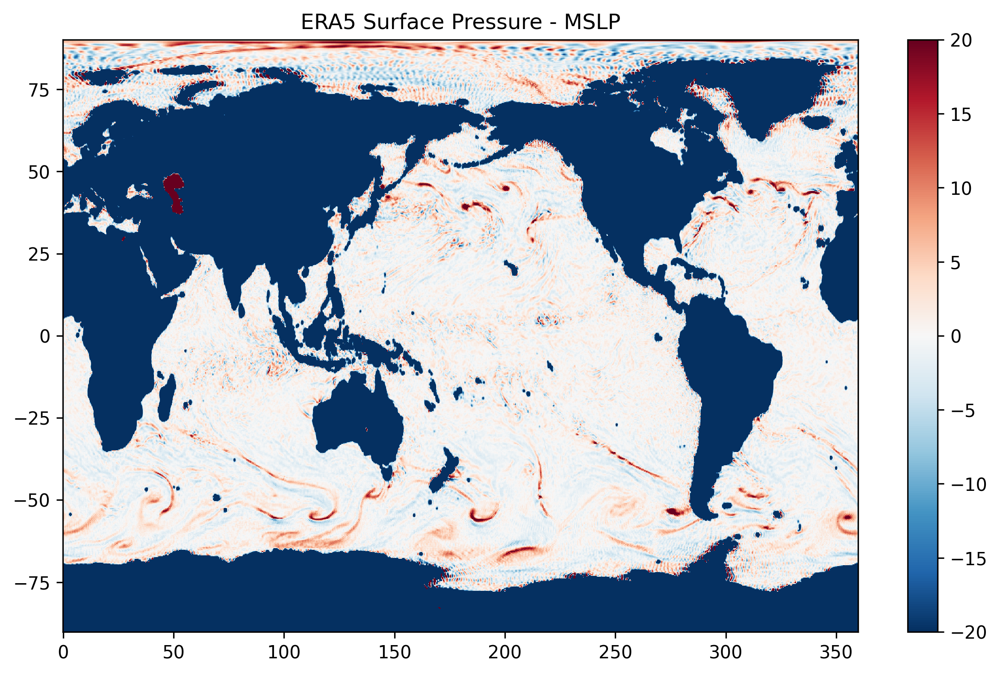

In [115]:
plt.figure(figsize=(10, 6), dpi=300)
plt.pcolormesh(
    gds["longitude"],
    gds["latitude"],
    gaussian_filter(gds["surface_pressure"].sel(time="2010-01-02 00:00"), 1)
    - gds["mean_sea_level_pressure"].sel(time="2010-01-02 00:00"),
    vmin=-20,
    vmax=20,
    cmap="RdBu_r",
)
plt.colorbar()
plt.title("ERA5 Surface Pressure - MSLP")
plt.savefig("sp-mlsp_diff.png", dpi=300)

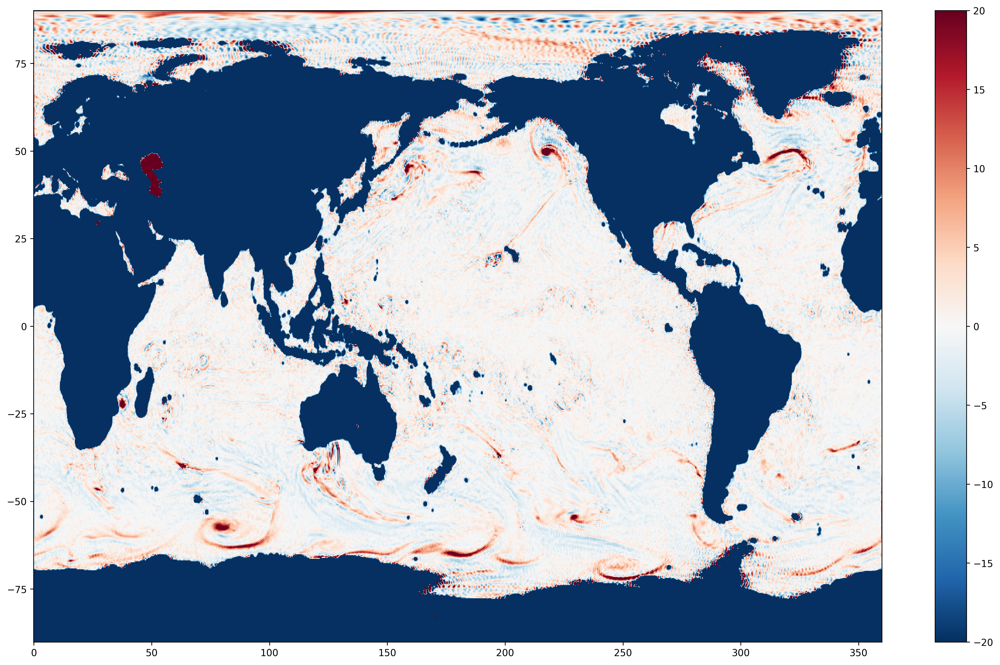

In [182]:
plt.figure(figsize=(20, 12), dpi=300)
plt.pcolormesh(
    gds["longitude"],
    gds["latitude"],
    gaussian_filter(gds["surface_pressure"].sel(time=ds["time"][0]), 1)
    - gds["mean_sea_level_pressure"].sel(time=ds["time"][0]),
    vmin=-20,
    vmax=20,
    cmap="RdBu_r",
)
plt.colorbar()

In [178]:
0.25**25

0.25

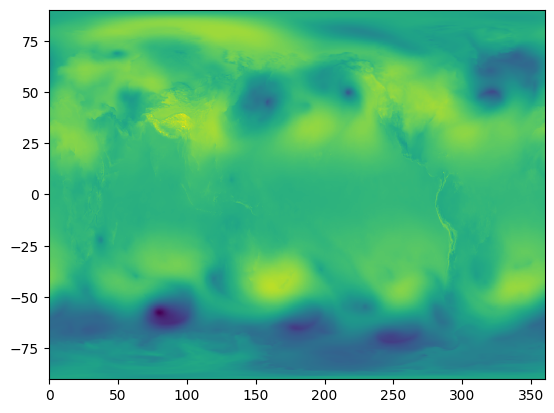

In [180]:
plt.pcolormesh(
    gds["longitude"],
    gds["latitude"],
    gds["mean_sea_level_pressure"].sel(time=ds["time"][0]),
)

In [192]:
gfs_ds = xr.open_dataset(
    "gs://global-forecast-system/gdas.20220213/00/atmos/gdas.t00z.sfcf000.nc",
    engine="h5netcdf",
)

In [193]:
gfs_ds

<xarray.Dataset> Size: 3GB
Dimensions:        (grid_xt: 3072, grid_yt: 1536, time: 1)
Coordinates:
  * grid_xt        (grid_xt) float64 25kB 0.0 0.1172 0.2344 ... 359.8 359.9
  * grid_yt        (grid_yt) float64 12kB 89.91 89.79 89.68 ... -89.79 -89.91
  * time           (time) object 8B 2022-02-13 00:00:00
Data variables: (12/150)
    lon            (grid_yt, grid_xt) float64 38MB ...
    lat            (grid_yt, grid_xt) float64 38MB ...
    acond          (time, grid_yt, grid_xt) float32 19MB ...
    albdo_ave      (time, grid_yt, grid_xt) float32 19MB ...
    alnsf          (time, grid_yt, grid_xt) float32 19MB ...
    alnwf          (time, grid_yt, grid_xt) float32 19MB ...
    ...             ...
    xtts           (time, grid_yt, grid_xt) float32 19MB ...
    xu             (time, grid_yt, grid_xt) float32 19MB ...
    xv             (time, grid_yt, grid_xt) float32 19MB ...
    xz             (time, grid_yt, grid_xt) float32 19MB ...
    xzts           (time, grid_yt, grid_xt) float32 19MB ...
    zc             (time, grid_yt, grid_xt) float32 19MB ...
Attributes:
    fhzero:       6
    ncld:         5
    nsoil:        4
    imp_physics:  11
    dtp:          150.0
    source:       FV3GFS
    grid:         gaussian
    im:           3072
    jm:           1536

In [194]:
gfs_atm = xr.open_dataset(
    "gs://global-forecast-system/gdas.20220213/00/atmos/gdas.t00z.atmf000.nc",
    engine="h5netcdf",
)

In [195]:
gfs_atm

<xarray.Dataset> Size: 31GB
Dimensions:  (grid_xt: 3072, grid_yt: 1536, pfull: 127, phalf: 128, time: 1)
Coordinates:
  * grid_xt  (grid_xt) float64 25kB 0.0 0.1172 0.2344 ... 359.6 359.8 359.9
  * grid_yt  (grid_yt) float64 12kB 89.91 89.79 89.68 ... -89.68 -89.79 -89.91
  * pfull    (pfull) float32 508B 0.01278 0.02033 0.03177 ... 993.5 996.2 998.8
  * phalf    (phalf) float32 512B 0.00999 0.01605 0.02532 ... 994.9 997.5 1e+03
  * time     (time) object 8B 2022-02-13 00:00:00
Data variables: (12/17)
    lon      (grid_yt, grid_xt) float64 38MB ...
    lat      (grid_yt, grid_xt) float64 38MB ...
    clwmr    (time, pfull, grid_yt, grid_xt) float32 2GB ...
    delz     (time, pfull, grid_yt, grid_xt) float32 2GB ...
    dpres    (time, pfull, grid_yt, grid_xt) float32 2GB ...
    dzdt     (time, pfull, grid_yt, grid_xt) float32 2GB ...
    ...       ...
    rwmr     (time, pfull, grid_yt, grid_xt) float32 2GB ...
    snmr     (time, pfull, grid_yt, grid_xt) float32 2GB ...
    spfh     (time, pfull, grid_yt, grid_xt) float32 2GB ...
    tmp      (time, pfull, grid_yt, grid_xt) float32 2GB ...
    ugrd     (time, pfull, grid_yt, grid_xt) float32 2GB ...
    vgrd     (time, pfull, grid_yt, grid_xt) float32 2GB ...
Attributes:
    hydrostatic:  non-hydrostatic
    ncnsto:       9
    ak:           [9.9900001e-01 1.6050000e+00 2.5320001e+00 3.9240000e+00 5....
    bk:           [0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0....
    source:       FV3GFS
    grid:         gaussian
    im:           3072
    jm:           1536

In [86]:
gfs_ds2 = xr.open_dataset(
    "gs://global-forecast-system/gfs.20250101/00/atmos/gfs.t00z.atmf006.nc",
    engine="h5netcdf",
)

In [109]:
gfs_ds2["hgtsfc"]

<xarray.DataArray 'hgtsfc' (time: 1, grid_yt: 1536, grid_xt: 3072)> Size: 19MB
array([[[   0.    ,    0.    , ...,    0.    ,    0.    ],
        [   0.    ,    0.    , ...,    0.    ,    0.    ],
        ...,
        [2774.8533, 2774.9246, ..., 2774.7104, 2774.7817],
        [2774.1948, 2774.2212, ..., 2774.1423, 2774.1685]]],
      shape=(1, 1536, 3072), dtype=float32)
Coordinates:
  * grid_xt  (grid_xt) float64 25kB 0.0 0.1172 0.2344 ... 359.6 359.8 359.9
  * grid_yt  (grid_yt) float64 12kB 89.91 89.79 89.68 ... -89.68 -89.79 -89.91
  * time     (time) object 8B 2025-01-01 06:00:00
Attributes:
    long_name:     surface geopotential height
    units:         gpm
    cell_methods:  time: point
    output_file:   atm

(20.0, 60.0)

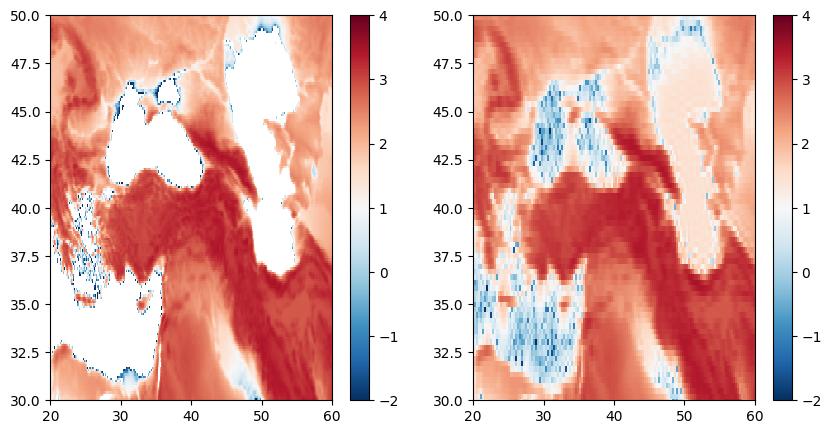

In [107]:
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.pcolormesh(
    gfs_ds2["lon"],
    gfs_ds2["lat"],
    np.log10(gfs_ds2["hgtsfc"][0]),
    cmap="RdBu_r",
    vmin=-2,
    vmax=4,
)
plt.colorbar()
plt.ylim(30, 50)
plt.xlim(20, 60)
plt.subplot(1, 2, 2)

plt.pcolormesh(
    e5_static["longitude"],
    e5_static["latitude"],
    np.log10(np.abs((e5_static["Z_GDS4_SFC"])) / 9.81),
    cmap="RdBu_r",
    vmin=-2,
    vmax=4,
)
plt.colorbar()
plt.ylim(30, 50)
plt.xlim(20, 60)

/glade/u/home/dgagne/conda-envs/credit-casper/lib/python3.11/site-packages/xarray/core/computation.py:824: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)
/glade/u/home/dgagne/conda-envs/credit-casper/lib/python3.11/site-packages/xarray/core/computation.py:824: RuntimeWarning: invalid value encountered in log10
  result_data = func(*input_data)


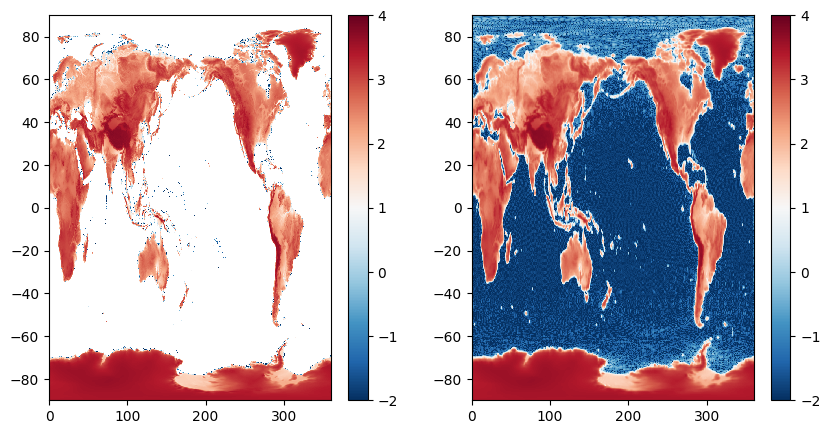

In [116]:
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.pcolormesh(
    gfs_ds2["lon"],
    gfs_ds2["lat"],
    np.log10(gfs_ds2["hgtsfc"][0]),
    cmap="RdBu_r",
    vmin=-2,
    vmax=4,
)
plt.colorbar()

plt.subplot(1, 2, 2)

plt.pcolormesh(
    e5_static["longitude"],
    e5_static["latitude"],
    np.log10(np.abs(gaussian_filter(e5_static["Z_GDS4_SFC"], 1)) / 9.81),
    cmap="RdBu_r",
    vmin=-2,
    vmax=4,
)
plt.colorbar()

In [ ]:
e5_static["Z_GDS4_SFC"]

In [199]:
gfs_nomads = xr.open_dataset(
    "https://nomads.ncep.noaa.gov/dods/gfs_0p25_1hr/gfs20250421/gfs_0p25_1hr_00z"
)

/glade/u/home/dgagne/conda-envs/credit-casper/lib/python3.11/site-packages/xarray/coding/times.py:200: SerializationWarning: Ambiguous reference date string: 1-1-1 00:00:0.0. The first value is assumed to be the year hence will be padded with zeros to remove the ambiguity (the padded reference date string is: 0001-1-1 00:00:0.0). To remove this message, remove the ambiguity by padding your reference date strings with zeros.
  ref_date = _ensure_padded_year(ref_date)


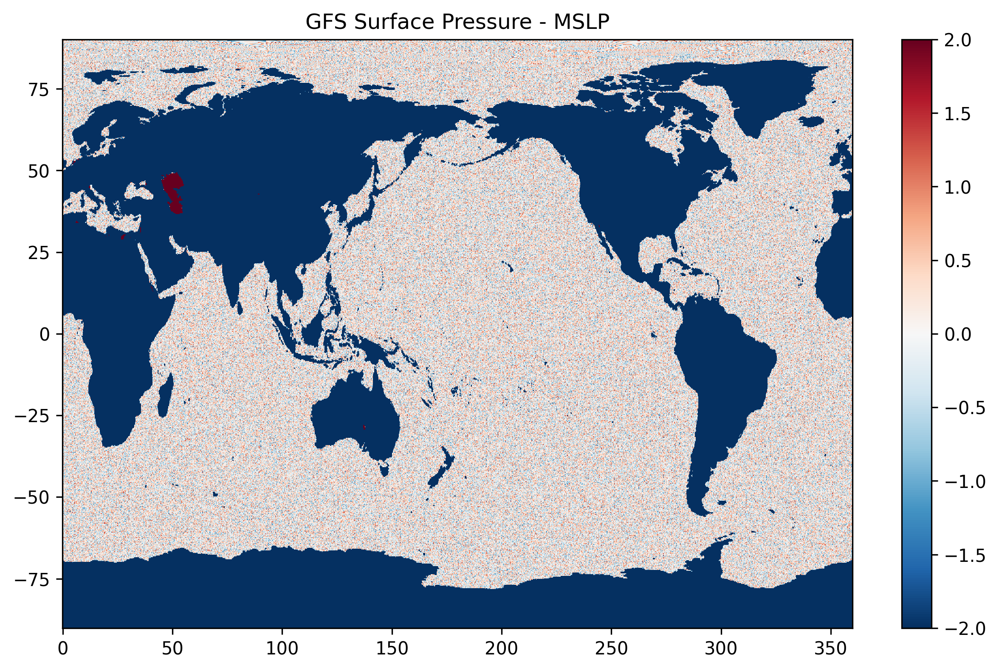

In [221]:
plt.figure(figsize=(10, 6), dpi=300)
plt.pcolormesh(
    gfs_nomads["lon"],
    gfs_nomads["lat"],
    gfs_nomads["pressfc"][0] - gfs_nomads["prmslmsl"][0],
    vmin=-2,
    vmax=2,
    cmap="RdBu_r",
)
plt.colorbar()
plt.title("GFS Surface Pressure - MSLP")
plt.savefig("gfs_press_comp.png", dpi=300, bbox_inches="tight")

In [211]:
gfs_nomads["prmslmsl"].attrs

{'long_name': '** mean sea level pressure reduced to msl [pa] '}

In [3]:
gfs_ds = xr.open_dataset(
    "/glade/derecho/scratch/dgagne/gfs_init/gfs_init_20250501_0000.zarr"
)

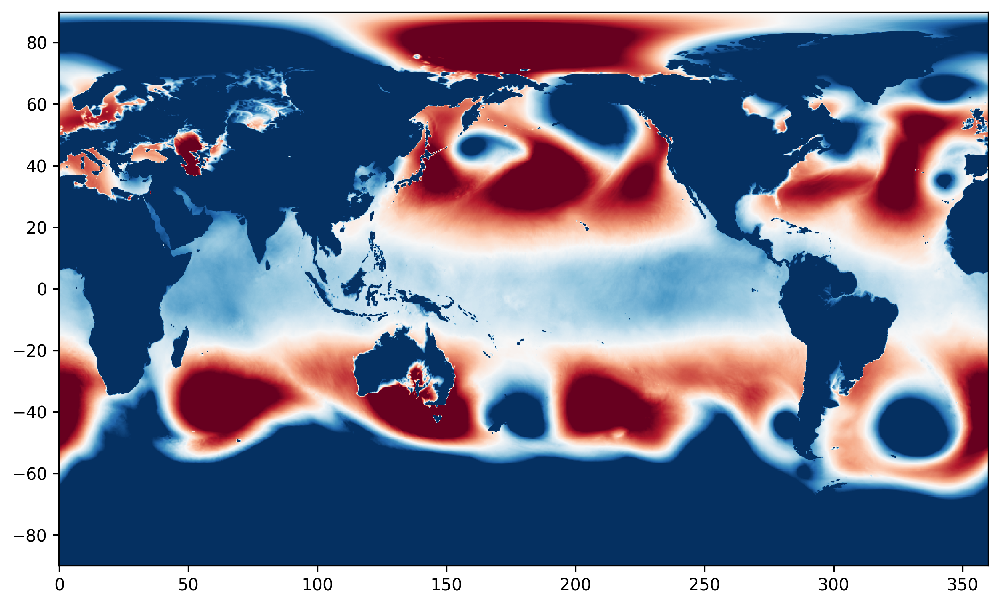

In [9]:
plt.figure(figsize=(10, 6), dpi=300)
plt.pcolormesh(
    gfs_ds["longitude"],
    gfs_ds["latitude"],
    gfs_ds["SP"][0] / 100.0 - 1013.25,
    vmin=-10,
    vmax=10,
    cmap="RdBu_r",
)

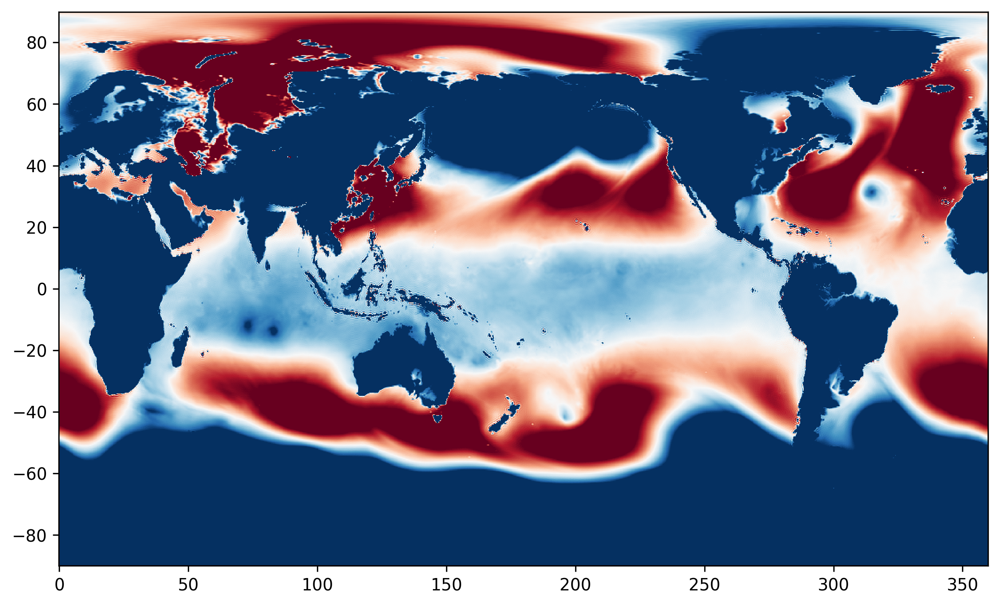

In [11]:
plt.figure(figsize=(10, 6), dpi=300)
plt.pcolormesh(
    gfs_ds["longitude"],
    gfs_ds["latitude"],
    eds["SP"][0] / 100.0 - 1013.25,
    vmin=-10,
    vmax=10,
    cmap="RdBu_r",
)